# BEVFormer Attack Demo

### Praparation

Load dependence

In [1]:
# an workaround to load path
import sys
sys.path.append('/home/cixie/shaoyuan/BEV-Attack/zoo/BEVFormer')
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [2]:
import argparse
import mmcv
import torch
import warnings
from typing import Tuple
from mmcv import Config, DictAction
from mmcv.cnn import fuse_conv_bn
from mmcv.parallel import MMDataParallel, MMDistributedDataParallel
from mmcv.runner import (get_dist_info, init_dist, load_checkpoint,
                         wrap_fp16_model)

from mmdet3d.datasets import build_dataset
from projects.mmdet3d_plugin.datasets.builder import build_dataloader
from mmdet3d.models import build_model
from mmdet.apis import set_random_seed
from mmdet.datasets import replace_ImageToTensor
import time
import os.path as osp

from attacks.attacker.builder import build_attack
import attacks.dataset
import attacks.bbox
import attacks.losses
from attacks.utils import single_gpu_attack

specify mmcv config file and checkpoint

In [3]:
config = '/home/cixie/shaoyuan/BEV-Attack/zoo/BEVFormer/projects/configs/bevformer/bevformer_base_adv.py'
checkpoint_path = '/home/cixie/shaoyuan/BEV-Attack/models/bevformer/bevformer_r101_dcn_24ep.pth'

parse config file and import mmdet plugin module

In [4]:
cfg = Config.fromfile(config)
# import modules from string list.
if cfg.get('custom_imports', None):
    from mmcv.utils import import_modules_from_strings
    import_modules_from_strings(**cfg['custom_imports'])

# import modules from plguin/xx, registry will be updated
if hasattr(cfg, 'plugin'):
    if cfg.plugin:
        import importlib
        if hasattr(cfg, 'plugin_dir'):
            if isinstance(cfg.plugin_dir, str):
                cfg.plugin_dir = [cfg.plugin_dir]
            # import multi plugin modules
            for plugin_dir_ in cfg.plugin_dir:
                _module_dir = os.path.dirname(plugin_dir_)
                _module_dir = _module_dir.split('/')
                _module_path = _module_dir[0]

                for m in _module_dir[1:]:
                    _module_path = _module_path + '.' + m
                print('load python module {}'.format(_module_path))
                plg_lib = importlib.import_module(_module_path)

load python module projects.mmdet3d_plugin
load python module attacks


build dataset and dataloader

In [5]:
# set cudnn_benchmark
if cfg.get('cudnn_benchmark', False):
    torch.backends.cudnn.benchmark = True

cfg.model.pretrained = None
# in case the test dataset is concatenated
samples_per_gpu = 1
if isinstance(cfg.data.test, dict):
    cfg.data.test.test_mode = True
    samples_per_gpu = cfg.data.test.pop('samples_per_gpu', 1)
    if samples_per_gpu > 1:
        # Replace 'ImageToTensor' to 'DefaultFormatBundle'
        cfg.data.test.pipeline = replace_ImageToTensor(
            cfg.data.test.pipeline)
elif isinstance(cfg.data.test, list):
    for ds_cfg in cfg.data.test:
        ds_cfg.test_mode = True
    samples_per_gpu = max(
        [ds_cfg.pop('samples_per_gpu', 1) for ds_cfg in cfg.data.test])
    if samples_per_gpu > 1:
        for ds_cfg in cfg.data.test:
            ds_cfg.pipeline = replace_ImageToTensor(ds_cfg.pipeline)


# build the dataloader
# It seems set in config don't work
# an ugly workaround to set test_mode = False
cfg.data.test.test_mode = False
dataset = build_dataset(cfg.data.test)
data_loader = build_dataloader(
    dataset,
    samples_per_gpu=samples_per_gpu,
    workers_per_gpu=cfg.data.workers_per_gpu,
    dist=False,
    shuffle=False,
    nonshuffler_sampler=cfg.data.nonshuffler_sampler,
)

WARNING!!!!, Only can be used for obtain inference speed!!!!


build model and attacker

In [6]:
attacker = build_attack(cfg.attack)

# build the model and load checkpoint
cfg.model.train_cfg = None
model = build_model(cfg.model, test_cfg=cfg.get('test_cfg'))
fp16_cfg = cfg.get('fp16', None)
if fp16_cfg is not None:
    wrap_fp16_model(model)
checkpoint = load_checkpoint(model, checkpoint_path, map_location='cpu')

# old versions did not save class info in checkpoints, this walkaround is
# for backward compatibility
if 'CLASSES' in checkpoint.get('meta', {}):
    model.CLASSES = checkpoint['meta']['CLASSES']
else:
    model.CLASSES = dataset.CLASSES
# palette for visualization in segmentation tasks
if 'PALETTE' in checkpoint.get('meta', {}):
    model.PALETTE = checkpoint['meta']['PALETTE']
elif hasattr(dataset, 'PALETTE'):
    # segmentation dataset has `PALETTE` attribute
    model.PALETTE = dataset.PALETTE

for n, p in model.named_parameters():
    p.requires_grad = False
model = MMDataParallel(model, device_ids=[0])

/home/cixie/shaoyuan/BEV-Attack/zoo/BEVFormer/projects/mmdet3d_plugin/bevformer/modules/custom_base_transformer_layer.py:94: UserWarning: The arguments `feedforward_channels` in BaseTransformerLayer has been deprecated, now you should set `feedforward_channels` and other FFN related arguments to a dict named `ffn_cfgs`. 
  warnings.warn(
/home/cixie/shaoyuan/BEV-Attack/zoo/BEVFormer/projects/mmdet3d_plugin/bevformer/modules/custom_base_transformer_layer.py:94: UserWarning: The arguments `ffn_dropout` in BaseTransformerLayer has been deprecated, now you should set `ffn_drop` and other FFN related arguments to a dict named `ffn_cfgs`. 
  warnings.warn(
/home/cixie/shaoyuan/BEV-Attack/zoo/BEVFormer/projects/mmdet3d_plugin/bevformer/modules/custom_base_transformer_layer.py:94: UserWarning: The arguments `ffn_num_fcs` in BaseTransformerLayer has been deprecated, now you should set `num_fcs` and other FFN related arguments to a dict named `ffn_cfgs`. 
  warnings.warn(
/home/cixie/.local/lib/

load checkpoint from local path: /home/cixie/shaoyuan/BEV-Attack/models/bevformer/bevformer_r101_dcn_24ep.pth


2022-10-05 02:46:54,411 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.0.conv2 is upgraded to version 2.
2022-10-05 02:46:54,415 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.1.conv2 is upgraded to version 2.
2022-10-05 02:46:54,417 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.2.conv2 is upgraded to version 2.
2022-10-05 02:46:54,420 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.3.conv2 is upgraded to version 2.
2022-10-05 02:46:54,422 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.4.conv2 is upgraded to version 2.
2022-10-05 02:46:54,425 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.5.conv2 is upgraded to version 2.
2022-10-05 02:46:54,427 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.6.conv2 is upgraded to version 2.
2022-10-05 02:46:54,430 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.7.conv2 is upgraded to version 2.
2022-10-05 02:46:54,432 - root - INFO - ModulatedDeformC

fetch data from iterable `data_loader`

In [7]:
data_loader = iter(data_loader)
data = next(data_loader)

run attack and generate adversarial input data, this may take some time and GPU memory (around 30GB)

In [8]:
inputs = attacker.run(model, data_loader)

In [9]:
orig_img = data['img'][0].data[0].squeeze()
adv_img = inputs['img'][0].data[0].squeeze()

In [10]:
def normalize(img, img_norm_cfg):
    mean = torch.tensor(img_norm_cfg['mean']).view(3, 1, 1)
    std = torch.tensor(img_norm_cfg['std']).view(3, 1, 1)
    img = img * std + mean
    img /= 255
    return img

In [11]:
print(orig_img.size())
print(adv_img.size())

torch.Size([6, 3, 928, 1600])
torch.Size([6, 3, 928, 1600])


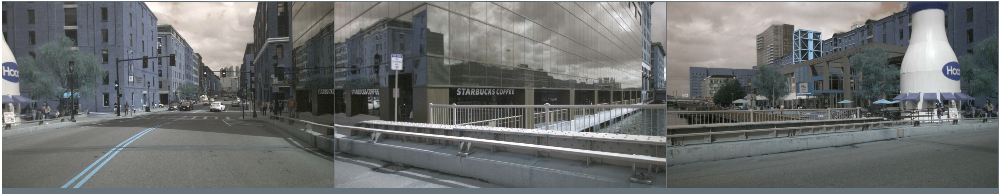

In [12]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from torchvision.utils import make_grid

import torchvision.transforms.functional as F

def show(imgs):
    plt.rcParams['figure.figsize'] = (100.0, 80.0)
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        axs[0, i].imshow(normalize(img, cfg.img_norm_cfg).permute(1,2,0))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

orig_grid = make_grid(orig_img[:3])
show(orig_grid)

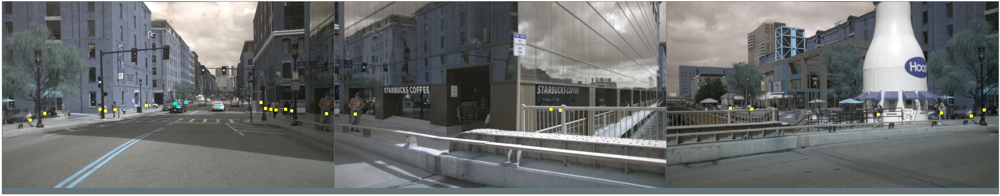

In [13]:
adv_grid = make_grid(adv_img[:3])
show(adv_grid)